In [112]:
import numpy as np
import pydicom
import matplotlib.pyplot as plt
import os
import glob
import pandas as pd
from mask_functions import rle2mask,mask2rle

sample_path = "./siim-acr-pneumothorax-segmentation/sample images/"

In [2]:
def show_dcm_info(dataset):
    print("Filename.........:", file_path)
    print("Storage type.....:", dataset.SOPClassUID)
    print()

    pat_name = dataset.PatientName
    display_name = pat_name.family_name + ", " + pat_name.given_name
    print("Patient's name......:", display_name)
    print("Patient id..........:", dataset.PatientID)
    print("Patient's Age.......:", dataset.PatientAge)
    print("Patient's Sex.......:", dataset.PatientSex)
    print("Modality............:", dataset.Modality)
    print("Body Part Examined..:", dataset.BodyPartExamined)
    print("View Position.......:", dataset.ViewPosition)
    
    if 'PixelData' in dataset:
        rows = int(dataset.Rows)
        cols = int(dataset.Columns)
        print("Image size.......: {rows:d} x {cols:d}, {size:d} bytes".format(
            rows=rows, cols=cols, size=len(dataset.PixelData)))
        if 'PixelSpacing' in dataset:
            print("Pixel spacing....:", dataset.PixelSpacing)

def plot_pixel_array(dataset, figsize=(10,10)):
    plt.figure(figsize=figsize)
    plt.imshow(dataset.pixel_array, cmap=plt.cm.bone)
    plt.show()

Filename.........: ./siim-acr-pneumothorax-segmentation/sample images\1.2.276.0.7230010.3.1.4.8323329.1000.1517875165.878027.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Patient's name......: 17d405a3-a0d2-4901-b33a-63906aa48d9f, 
Patient id..........: 17d405a3-a0d2-4901-b33a-63906aa48d9f
Patient's Age.......: 38
Patient's Sex.......: M
Modality............: CR
Body Part Examined..: CHEST
View Position.......: PA
Image size.......: 1024 x 1024, 130476 bytes
Pixel spacing....: ['0.168', '0.168']


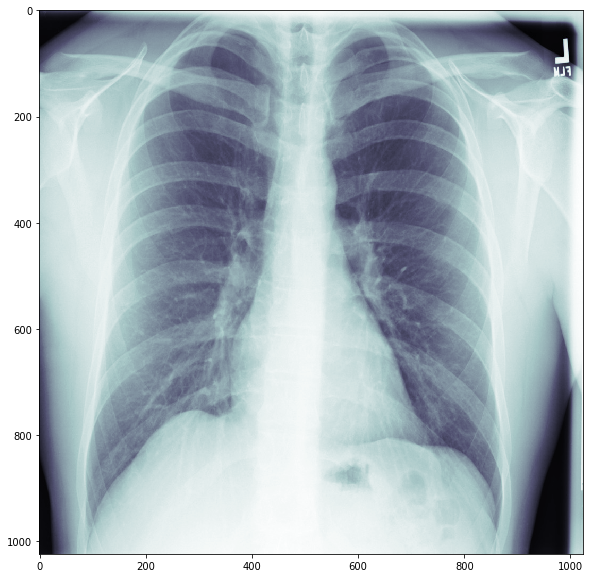

In [3]:
for file_path in (glob.glob(sample_path+'*.dcm')):
    data = pydicom.dcmread(file_path)
    show_dcm_info(data)
    plot_pixel_array(data)
    break

(64, 128, 128, 1)


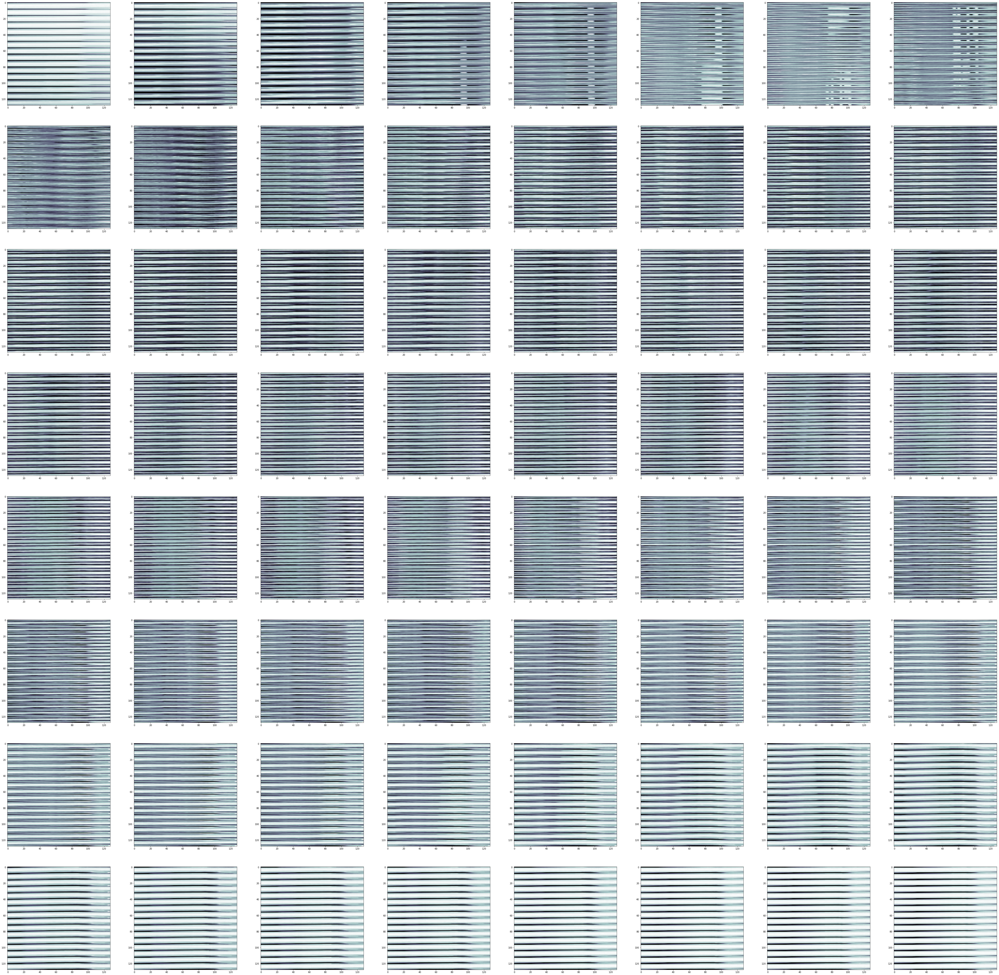

In [18]:
path_test = (sample_path+'1.2.276.0.7230010.3.1.4.8323329.1000.1517875165.878027.dcm')
data2 = pydicom.dcmread(file_path)
#plot_pixel_array(data2)
imgg = data2.pixel_array
imgg = imgg.reshape((-1,128,128,1))
num_img = len(imgg)
print(imgg.shape)
fig, ax = plt.subplots(8, 8, figsize=(8*10,8*10))
for i in range(num_img):
    plt.subplot(8,8,i+1),plt.imshow(imgg[i,:,:,0], cmap=plt.cm.bone)

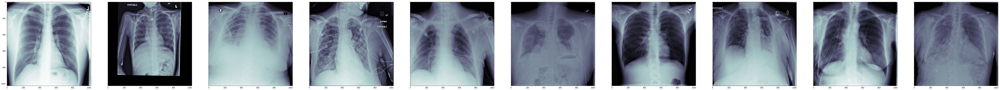

In [19]:
num_img = len(glob.glob(sample_path+'*.dcm'))
fig, ax = plt.subplots(1, num_img, sharey=True, figsize=(num_img*10,10))
for q, file_path in enumerate(glob.glob(sample_path+'*.dcm')):
    dataset = pydicom.dcmread(file_path)
    #show_dcm_info(dataset)
    ax[q].imshow(dataset.pixel_array, cmap=plt.cm.bone)

In [21]:
df = pd.read_csv(sample_path+'train-rle-sample.csv', header=None, index_col=0)
df

,1
0,
1.2.276.0.7230010.3.1.4.8323329.1000.1517875165.878027,-1
1.2.276.0.7230010.3.1.4.8323329.10000.1517875220.938530,-1
1.2.276.0.7230010.3.1.4.8323329.10001.1517875220.930580,-1
1.2.276.0.7230010.3.1.4.8323329.10002.1517875220.939397,-1
1.2.276.0.7230010.3.1.4.8323329.10003.1517875220.942420,-1
1.2.276.0.7230010.3.1.4.8323329.4904.1517875185.355709,175349 7 1013 12 1009 17 1005 19 1003 20 1002...
1.2.276.0.7230010.3.1.4.8323329.1314.1517875167.222290,119331 47 972 82 937 107 912 122 897 137 882 ...
1.2.276.0.7230010.3.1.4.8323329.4440.1517875182.865105,532609 13 1005 19 1002 21 999 25 989 32 988 3...
1.2.276.0.7230010.3.1.4.8323329.4982.1517875185.837576,291062 6 1015 10 1013 11 1011 13 1010 13 1010...


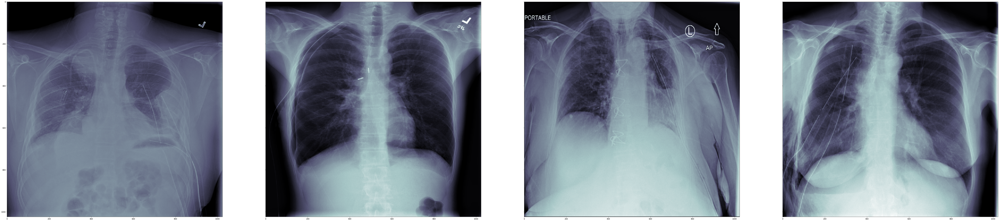

In [22]:
fig, ax = plt.subplots(nrows=1, ncols=4, sharey=True, figsize=(num_img*10,40))
for q, file_path in enumerate(glob.glob(sample_path+'*.dcm')[5:9]):
    dataset = pydicom.dcmread(file_path)
    #print(file_path.split('\\')[-1][:-4])
    ax[q].imshow(dataset.pixel_array, cmap=plt.cm.bone)

1.2.276.0.7230010.3.1.4.8323329.12743.1517875241.599591
1.2.276.0.7230010.3.1.4.8323329.1314.1517875167.222290
1.2.276.0.7230010.3.1.4.8323329.4440.1517875182.865105
1.2.276.0.7230010.3.1.4.8323329.4904.1517875185.355709


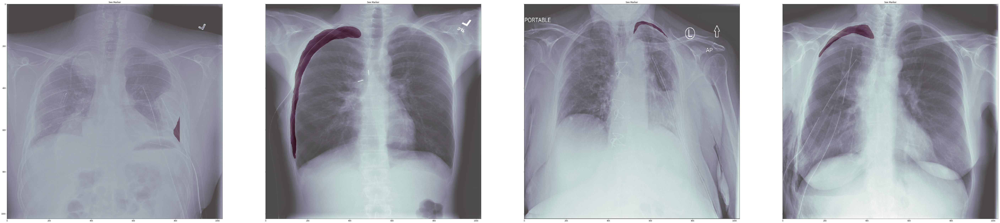

In [23]:
fig, ax = plt.subplots(nrows=1, ncols=4, sharey=True, figsize=(num_img*10,40))
for q, file_path in enumerate(glob.glob(sample_path+'*.dcm')[5:9]):
    dataset = pydicom.dcmread(file_path)
    print(file_path.split('\\')[-1][:-4])
    ax[q].imshow(dataset.pixel_array, cmap=plt.cm.bone)
    if df.loc[file_path.split('\\')[-1][:-4],1] != '-1':
        mask = rle2mask(df.loc[file_path.split('\\')[-1][:-4],1], 1024, 1024).T
        ax[q].set_title('See Marker')
        ax[q].imshow(mask, alpha=0.3, cmap="Reds")
    else:
        ax[q].set_title('Nothing to see')

In [24]:
os.listdir(os.getcwd()+'/pneumothorax')
df_full = pd.read_csv('./pneumothorax/train-rle.csv', index_col='ImageId')

In [25]:
train_glob = './pneumothorax/dicom-images-train/*/*/*.dcm'
test_glob = './pneumothorax/dicom-images-train/*/*/*.dcm'
train_fns = sorted(glob.glob(train_glob))[:5000]
df_full = pd.read_csv('./pneumothorax/train-rle.csv', index_col='ImageId')

In [72]:
from tqdm import tqdm_notebook
from keras import backend as K
import sys

im_height = 1024
im_width = 1024
im_chan = 1
# Get train images and masks
X_train = np.zeros((len(train_fns), im_height, im_width, im_chan), dtype=np.uint8)
Y_train = np.zeros((len(train_fns), im_height, im_width, 1), dtype=np.bool)
print('Getting train images and masks ... ')
sys.stdout.flush()
for n, _id in tqdm_notebook(enumerate(train_fns), total=len(train_fns)):
    dataset = pydicom.read_file(_id)
    X_train[n] = np.expand_dims(dataset.pixel_array, axis=2)
    try:
        if '-1' in df_full.loc[_id.split('\\')[-1][:-4],' EncodedPixels']:
            Y_train[n] = np.zeros((1024, 1024, 1))
        else:
            if type(df_full.loc[_id.split('\\')[-1][:-4],' EncodedPixels']) == str:
                Y_train[n] = np.expand_dims(rle2mask(df_full.loc[_id.split('\\')[-1][:-4],' EncodedPixels'], 1024, 1024).T, axis=2)
            else:
                Y_train[n] = np.zeros((1024, 1024, 1))
                for x in df_full.loc[_id.split('\\')[-1][:-4],' EncodedPixels']:
                    Y_train[n] =  Y_train[n] + np.expand_dims(rle2mask(x, 1024, 1024).T, axis=2)
            
    except KeyError:
        #print(f"Key {_id.split('/')[-1][:-4]} without mask, assuming healthy patient.")
        Y_train[n] = np.zeros((1024, 1024, 1)) # Assume missing masks are empty masks.

print('Done!')

Getting train images and masks ... 



Done!


In [28]:
X_train.shape

(5000, 1024, 1024, 1)

In [22]:
im_height = 128
im_width = 128
X_train = X_train.reshape((-1, im_height, im_width, 1))
Y_train = Y_train.reshape((-1, im_height, im_width, 1))

In [29]:
def dice_coef(y_true, y_pred, smooth=1):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

In [30]:
from keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose, concatenate
from keras.models import Model

inputs = Input((None, None, im_chan))

c1 = Conv2D(8, (3, 3), activation='relu', padding='same') (inputs)
c1 = Conv2D(8, (3, 3), activation='relu', padding='same') (c1)
p1 = MaxPooling2D((2, 2)) (c1)

c2 = Conv2D(16, (3, 3), activation='relu', padding='same') (p1)
c2 = Conv2D(16, (3, 3), activation='relu', padding='same') (c2)
p2 = MaxPooling2D((2, 2)) (c2)

c3 = Conv2D(32, (3, 3), activation='relu', padding='same') (p2)
c3 = Conv2D(32, (3, 3), activation='relu', padding='same') (c3)
p3 = MaxPooling2D((2, 2)) (c3)

c4 = Conv2D(64, (3, 3), activation='relu', padding='same') (p3)
c4 = Conv2D(64, (3, 3), activation='relu', padding='same') (c4)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

c5 = Conv2D(64, (3, 3), activation='relu', padding='same') (p4)
c5 = Conv2D(64, (3, 3), activation='relu', padding='same') (c5)
p5 = MaxPooling2D(pool_size=(2, 2)) (c5)

c55 = Conv2D(128, (3, 3), activation='relu', padding='same') (p5)
c55 = Conv2D(128, (3, 3), activation='relu', padding='same') (c55)

u6 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same') (c55)
u6 = concatenate([u6, c5])
c6 = Conv2D(64, (3, 3), activation='relu', padding='same') (u6)
c6 = Conv2D(64, (3, 3), activation='relu', padding='same') (c6)

u71 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c6)
u71 = concatenate([u71, c4])
c71 = Conv2D(32, (3, 3), activation='relu', padding='same') (u71)
c61 = Conv2D(32, (3, 3), activation='relu', padding='same') (c71)

u7 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c61)
u7 = concatenate([u7, c3])
c7 = Conv2D(32, (3, 3), activation='relu', padding='same') (u7)
c7 = Conv2D(32, (3, 3), activation='relu', padding='same') (c7)

u8 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])
c8 = Conv2D(16, (3, 3), activation='relu', padding='same') (u8)
c8 = Conv2D(16, (3, 3), activation='relu', padding='same') (c8)

u9 = Conv2DTranspose(8, (2, 2), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)
c9 = Conv2D(8, (3, 3), activation='relu', padding='same') (u9)
c9 = Conv2D(8, (3, 3), activation='relu', padding='same') (c9)

outputs = Conv2D(1, (1, 1), activation='sigmoid') (c9)

model = Model(inputs=[inputs], outputs=[outputs])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics = [dice_coef])
model.summary()

Instructions for updating:
Colocations handled automatically by placer.
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, None, None, 1 0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, None, None, 8 80          input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, None, None, 8 584         conv2d_1[0][0]                   
__________________________________________________________________________________________________
max_pooling2d_1 (MaxPooling2D)  (None, None, None, 8 0           conv2d_2[0][0]                   
_____________________________________

__________________________________________________________________________________________________
conv2d_21 (Conv2D)              (None, None, None, 8 1160        concatenate_5[0][0]              
__________________________________________________________________________________________________
conv2d_22 (Conv2D)              (None, None, None, 8 584         conv2d_21[0][0]                  
__________________________________________________________________________________________________
conv2d_23 (Conv2D)              (None, None, None, 1 9           conv2d_22[0][0]                  
Total params: 600,585
Trainable params: 600,585
Non-trainable params: 0
__________________________________________________________________________________________________


In [73]:
model.fit(X_train, Y_train, validation_split=.2, batch_size=4, epochs=5,verbose=2)

Train on 4000 samples, validate on 1000 samples
Epoch 1/5
 - 349s - loss: 0.0476 - dice_coef: 0.3611 - val_loss: 0.0515 - val_dice_coef: 0.3721
Epoch 2/5
 - 344s - loss: 0.0476 - dice_coef: 0.3611 - val_loss: 0.0515 - val_dice_coef: 0.3721
Epoch 3/5
 - 345s - loss: 0.0476 - dice_coef: 0.3841 - val_loss: 0.0515 - val_dice_coef: 0.3721
Epoch 4/5
 - 352s - loss: 0.0476 - dice_coef: 0.3621 - val_loss: 0.0515 - val_dice_coef: 0.3721
Epoch 5/5
 - 344s - loss: 0.0476 - dice_coef: 0.3671 - val_loss: 0.0515 - val_dice_coef: 0.3721


In [92]:
import cv2
test_fns = sorted(glob.glob(test_glob))

X_test = np.zeros((len(test_fns), 128, 128, im_chan), dtype=np.uint8)
sys.stdout.flush()
for n, _id in tqdm_notebook(enumerate(test_fns), total=len(test_fns)):
    dataset = pydicom.read_file(_id)
    X_test[n] = np.expand_dims(cv2.resize(dataset.pixel_array,(128,128)), axis=2)

In [93]:
X_test.shape

(10712, 128, 128, 1)

In [94]:
predict_result = np.zeros((len(X_test),128,128,1), dtype= np.uint8)

for idx, i in enumerate(tqdm_notebook(X_test)):
    data = np.expand_dims(i,axis=0)
    data_p = model.predict(data)
    predict_result[idx] = data_p

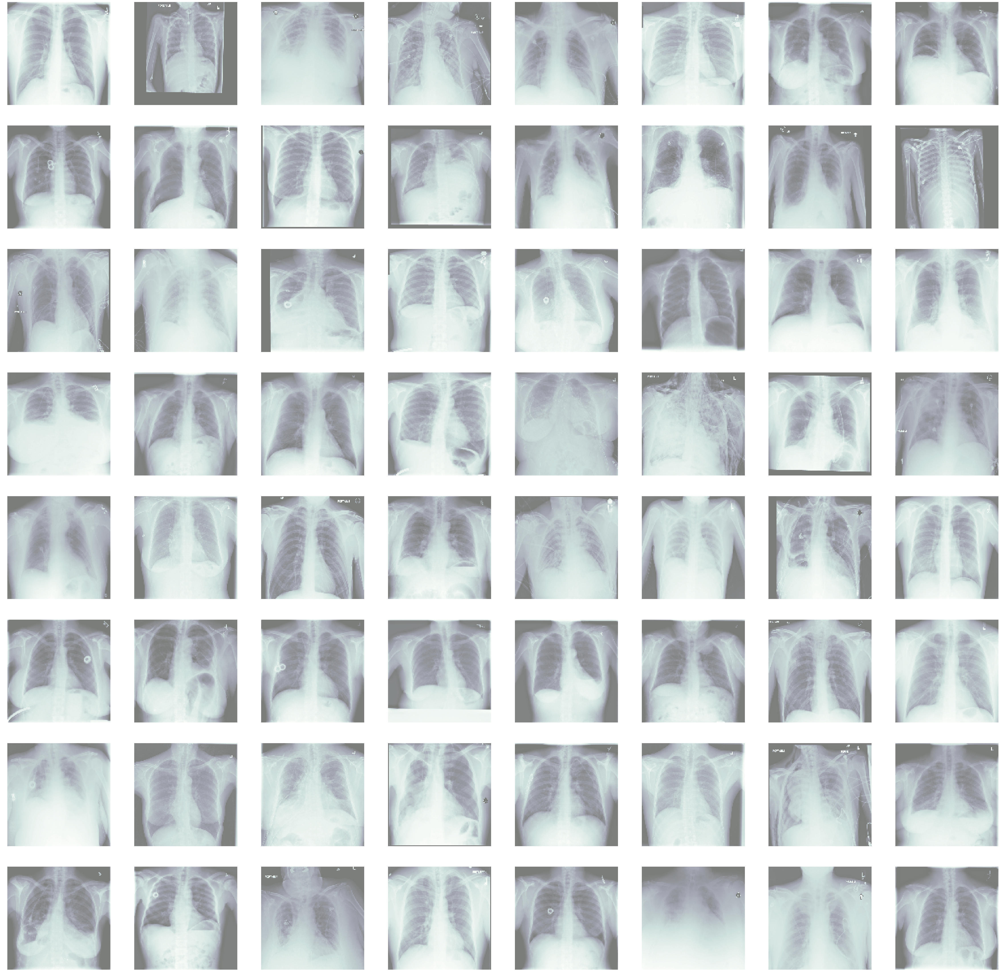

In [109]:
max_images = 64
grid_width = 8
grid_height = int(max_images / grid_width)
fig, axs = plt.subplots(grid_height, grid_width, figsize=(10*grid_width, 10*grid_height))

for i,(im, mask) in enumerate(zip(X_test[:64],predict_result[:64])):
    ax = axs[int(i / grid_width), i % grid_width]
    ax.imshow(im[...,0], cmap="bone")
    ax.imshow(mask.squeeze(), alpha=0.5, cmap="Greens")    
    ax.axis('off')

In [113]:
rles = []
i,max_img = 1,10
plt.figure(figsize=(16,4))
for p in tqdm_notebook(predict_result):
    p = p.squeeze()
    im = cv2.resize(p,(1024,1024))
#   zero out the smaller regions.
    if im.sum()<1024*2:
        im[:] = 0
    im = (im.T*255).astype(np.uint8)  
    rles.append(mask2rle(im, 1024, 1024))

<Figure size 1152x288 with 0 Axes>

In [114]:
ids = [o.split('/')[-1][:-4] for o in test_fns]
sub_df = pd.DataFrame({'ImageId': ids, 'EncodedPixels': rles})
sub_df.loc[sub_df.EncodedPixels=='', 'EncodedPixels'] = '-1'
sub_df.head()

,ImageId,EncodedPixels
0,dicom-images-train\1.2.276.0.7230010.3.1.2.832...,-1
1,dicom-images-train\1.2.276.0.7230010.3.1.2.832...,-1
2,dicom-images-train\1.2.276.0.7230010.3.1.2.832...,-1
3,dicom-images-train\1.2.276.0.7230010.3.1.2.832...,-1
4,dicom-images-train\1.2.276.0.7230010.3.1.2.832...,-1


In [115]:
sub_df.to_csv('orig_submission.csv', index=False)